In [41]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import  OneHotEncoder, StandardScaler, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score, RocCurveDisplay, ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score
import warnings
from sklearn.metrics import classification_report
warnings.filterwarnings("ignore", category=FutureWarning) # to avoid deprecation warnings

import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

In [42]:
df = pd.read_csv("conversion_data_train.csv")
df

,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0
...,...,...,...,...,...,...
284575,US,36,1,Ads,1,0
284576,US,31,1,Seo,2,0
284577,US,41,1,Seo,5,0
284578,US,31,1,Direct,4,0


In [43]:
df.shape

(284580, 6)

In [44]:
df.describe(include='all')

,country,age,new_user,source,total_pages_visited,converted
count,284580,284580.000000,284580.000000,284580,284580.000000,284580.000000
unique,4,NaN,NaN,3,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN
freq,160124,NaN,NaN,139477,NaN,NaN
mean,NaN,30.564203,0.685452,NaN,4.873252,0.032258
std,NaN,8.266789,0.464336,NaN,3.341995,0.176685
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000
75%,NaN,36.000000,1.000000,NaN,7.000000,0.000000


In [45]:
print ("nbre de valeurs null par colonne :\n")
df.isna().sum()

nbre de valeurs null par colonne :



country                0
age                    0
new_user               0
source                 0
total_pages_visited    0
converted              0
dtype: int64

In [46]:
px.histogram(df, 'country', 'converted')

In [47]:
px.histogram(df, 'age', 'converted')

In [48]:
px.histogram(df, 'source', 'converted')

In [49]:
px.histogram(df, 'total_pages_visited', 'converted')

In [50]:
target = 'converted'

x = df.drop(target, axis=1)
y = df[target].astype(str)

display(x.head(), y.head())

,country,age,new_user,source,total_pages_visited
0,China,22,1,Direct,2
1,UK,21,1,Ads,3
2,Germany,20,0,Seo,14
3,US,23,1,Seo,3
4,US,28,1,Direct,3


0    0
1    0
2    1
3    0
4    0
Name: converted, dtype: object

In [51]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42, stratify=y)

In [52]:
# Numerical # Standardize
# Categoric # Encode

x['new_user'] = x['new_user'].astype(str)

numerical_features = x.select_dtypes(include=np.number).columns.tolist()
categorical_features = x.select_dtypes(include=object).columns.tolist()


numerical_scaler = StandardScaler()
categorical_encoder = OneHotEncoder(drop='first')

numeric_pipeline = Pipeline([('numeric_scaler', numerical_scaler)])

categoric_pipeline = Pipeline([('categoric_encoder', categorical_encoder)])

preprocessor = ColumnTransformer([
  ('numeric_pipeline', numeric_pipeline, numerical_features),
  ('categoric_pipeline', categoric_pipeline, categorical_features),
                              ])

# Encode labels
label_encoder = LabelEncoder()
y_train = label_encoder.fit_transform(y_train)
y_test = label_encoder.transform(y_test)

print (numerical_features)
print (categorical_features)

['age', 'total_pages_visited']
['country', 'new_user', 'source']


In [53]:
preprocessor.fit(x_train)
x_train = preprocessor.transform(x_train)
x_test = preprocessor.transform(x_test)

print (x_train)
print (y_train)
print (x_test)

[[-1.27650481 -0.2618471   0.         ...  1.          0.
   0.        ]
 [-0.18867057 -0.56090876  0.         ...  1.          0.
   0.        ]
 [ 0.65742272 -0.56090876  0.         ...  0.          0.
   1.        ]
 ...
 [-1.03476387  0.63533789  0.         ...  1.          0.
   1.        ]
 [-0.18867057  0.03721457  0.         ...  0.          0.
   1.        ]
 [-0.0678001  -0.2618471   0.         ...  0.          0.
   1.        ]]
[0 0 0 ... 0 0 0]
[[ 0.17394084 -0.2618471   0.         ...  1.          0.
   1.        ]
 [-0.0678001   0.03721457  0.         ...  1.          0.
   1.        ]
 [ 0.05307037  0.03721457  0.         ...  1.          0.
   1.        ]
 ...
 [ 1.26177508 -0.56090876  0.         ...  1.          0.
   1.        ]
 [ 1.26177508  0.33627623  0.         ...  0.          0.
   0.        ]
 [-0.79302293 -0.56090876  0.         ...  1.          0.
   1.        ]]


In [54]:
# Train model
print("Train model...")
reg_log = LogisticRegression(max_iter = 1000)
reg_log.fit(x_train, y_train)
print("...Done.")

Train model...
...Done.


In [55]:
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix
import matplotlib.pyplot as plt
import pandas as pd

def graph_perf(dt_model, x_train, y_train, x_test, y_test, label_encoder, title):
    # Créer une figure avec deux sous-graphiques empilés verticalement
    fig, axes = plt.subplots(2, 2, figsize=(12, 8), gridspec_kw={'width_ratios': [1, 0.5]})
    fig.suptitle(title, fontsize=16)

    # Fonction pour afficher la matrice de confusion avec pourcentages
    def plot_confusion_matrix(ax, y_true, y_pred, labels):
        cm = confusion_matrix(y_true, y_pred, labels=label_encoder.transform(labels))
        cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
        disp.plot(cmap='Blues', values_format='d', ax=ax, colorbar=False)

        # Ajouter uniquement les pourcentages
        for i in range(cm.shape[0]):
            for j in range(cm.shape[1]):
                ax.text(j, i-0.1, f'({cm_normalized[i, j]*100:.1f}%)', 
                        ha='center', va='bottom', color='black', fontsize=10)


    # Matrice de confusion pour l'ensemble d'entraînement
    y_pred_train = dt_model.predict(x_train)
    plot_confusion_matrix(axes[0, 0], y_train, y_pred_train, label_encoder.classes_)
    axes[0, 0].set_title("Matrice de Confusion (Train)", fontsize=14)
    axes[0, 0].tick_params(axis='both', which='major', labelsize=12)

    # Matrice de confusion pour l'ensemble de test
    y_pred_test = dt_model.predict(x_test)
    plot_confusion_matrix(axes[1, 0], y_test, y_pred_test, label_encoder.classes_)
    axes[1, 0].set_title("Matrice de Confusion (Test)", fontsize=14)
    axes[1, 0].tick_params(axis='both', which='major', labelsize=12)

    # Fonction pour ajouter les métriques de performance sous forme de tableau
    def add_performance_table(ax, y_true, y_pred, labels):
        report = classification_report(y_true, y_pred, target_names=labels, output_dict=True)
        report_df = pd.DataFrame(report).transpose()

        # Arrondir les métriques à deux chiffres après la virgule
        report_df = report_df.applymap(lambda x: f'{x:.2f}' if isinstance(x, float) else x)

        # Afficher le tableau
        table = ax.table(cellText=report_df.values, colLabels=report_df.columns, rowLabels=report_df.index, cellLoc='center', loc='center')
        table.auto_set_font_size(False)
        table.set_fontsize(10)
        table.scale(1.2, 1.2)
        ax.axis('off')

    # Ajouter les métriques de performance pour l'ensemble d'entraînement
    add_performance_table(axes[0, 1], y_train, y_pred_train, label_encoder.classes_)
    axes[0, 1].set_title("Performance (Train)", fontsize=14)

    # Ajouter les métriques de performance pour l'ensemble de test
    add_performance_table(axes[1, 1], y_test, y_pred_test, label_encoder.classes_)
    axes[1, 1].set_title("Performance (Test)", fontsize=14)

    # Afficher le graphique
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

# Exemple d'utilisation de la fonction
# graph_perf(dt_best, x_train, y_train, x_test, y_test, label_encoder, title="Performance du Modèle")


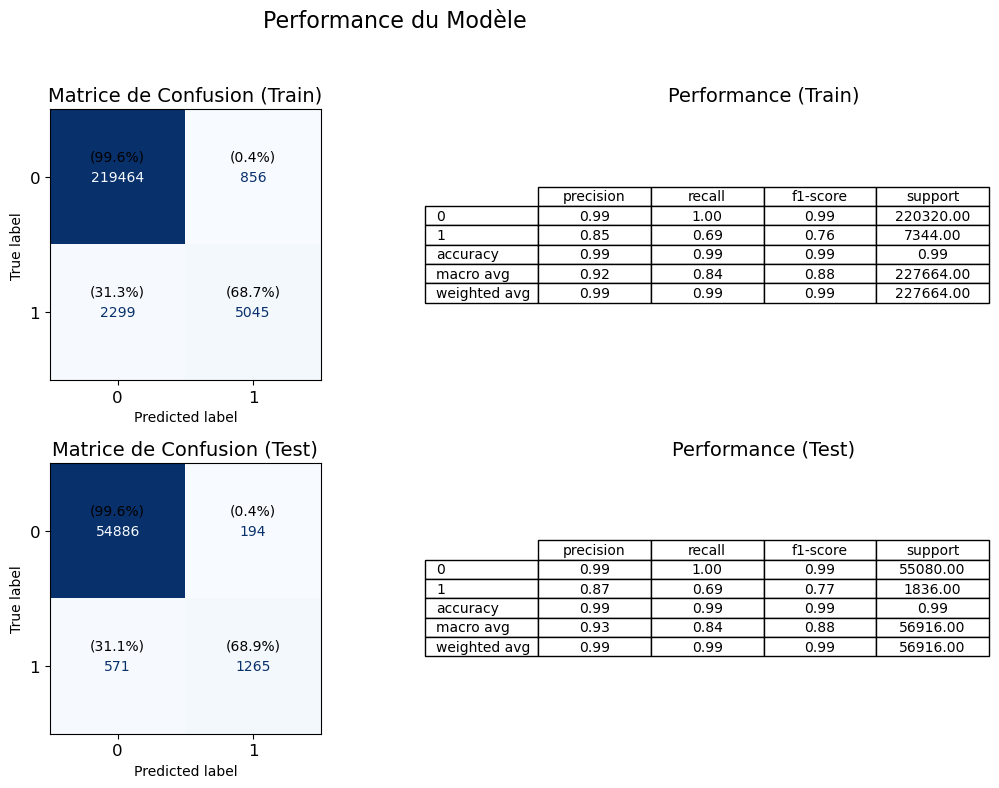

In [56]:
graph_perf(reg_log, x_train, y_train, x_test, y_test, label_encoder, title="Performance du Modèle")

In [57]:
# Read data without labels
data_without_labels = pd.read_csv('conversion_data_test.csv')
print('Prediction set (without labels) :', data_without_labels.shape)
data_without_labels



Prediction set (without labels) : (31620, 5)


,country,age,new_user,source,total_pages_visited
0,UK,28,0,Seo,16
1,UK,22,1,Direct,5
2,China,32,1,Seo,1
3,US,32,1,Ads,6
4,China,25,0,Seo,3
...,...,...,...,...,...
31615,Germany,25,1,Seo,3
31616,US,36,1,Ads,7
31617,UK,33,1,Seo,5
31618,UK,25,1,Seo,14


In [58]:
# WARNING : PUT HERE THE SAME PREPROCESSING AS FOR YOUR TEST SET
# CHECK YOU ARE USING X_without_labels
print("Encoding categorical features and standardizing numerical features...")

X_without_labels = preprocessor.transform(data_without_labels)
print("...Done")
print(X_without_labels[0:5,:])

Encoding categorical features and standardizing numerical features...
...Done
[[-0.30954104  3.32689285  0.          1.          0.          0.
   0.          1.        ]
 [-1.03476387  0.03721457  0.          1.          0.          1.
   1.          0.        ]
 [ 0.17394084 -1.15903208  0.          0.          0.          1.
   0.          1.        ]
 [ 0.17394084  0.33627623  0.          0.          1.          1.
   0.          0.        ]
 [-0.67215246 -0.56090876  0.          0.          0.          0.
   0.          1.        ]]


In [59]:
pred_test_file = reg_log.predict(X_without_labels)
pred_test_file

array([1, 0, 0, ..., 0, 1, 0])

In [60]:
# Make predictions and dump to file
# WARNING : MAKE SURE THE FILE IS A CSV WITH ONE COLUMN NAMED 'converted' AND NO INDEX !
# WARNING : FILE NAME MUST HAVE FORMAT 'conversion_data_test_predictions_[name].csv'
# where [name] is the name of your team/model separated by a '-'
# For example : [name] = AURELIE-model1
data = {
    'converted': pred_test_file}

suffixe = "jej-baseReglog"

Y_predictions = pd.DataFrame(columns=['converted'],data=data)
Y_predictions.to_csv(f"conversion_data_test_predictions_{suffixe}.csv", index=False)